In [1]:
import numpy as np
import matplotlib.pyplot as plt

# Interactive operations

To quickly plot something, use the following apis:

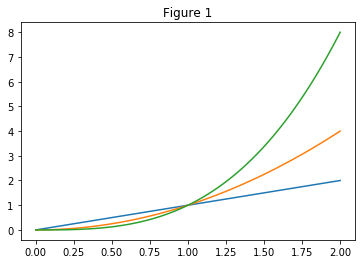

In [31]:
x = np.linspace(0, 2, 100)

plt.plot(x, x)
plt.plot(x, x**2)
plt.plot(x, x**3)

plt.title('Figure 1')

plt.show()

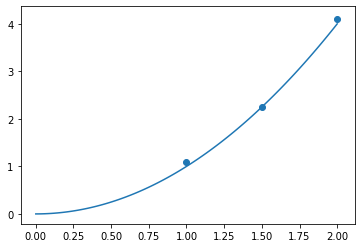

In [15]:
plt.plot(x, x**2)
plt.scatter([1, 1.5, 2], [1.1, 2.24, 4.1])

## Plot range, axis and on so

### Plot range

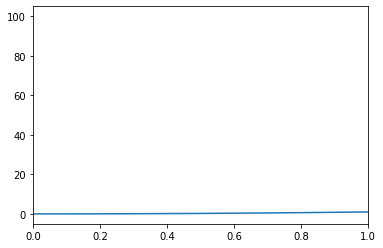

In [23]:
xp = np.linspace(0, 10, 1000)
plt.xlim(0, 1)
plt.plot(xp, xp**2)

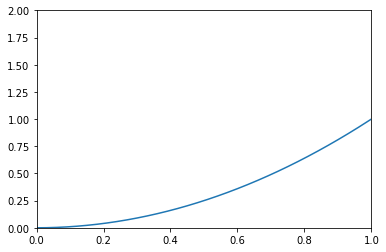

In [25]:
xp = np.linspace(0, 10, 1000)
plt.xlim(0, 1)
plt.ylim(0, 2)
plt.plot(xp, xp**2)

### Axis label

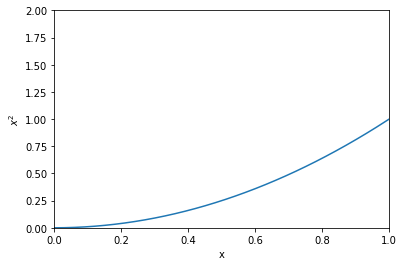

In [30]:
xp = np.linspace(0, 10, 1000)
plt.xlim(0, 1)
plt.ylim(0, 2)
plt.xlabel('x')
plt.ylabel('$x^2$')
plt.plot(xp, xp**2)

### Ticks

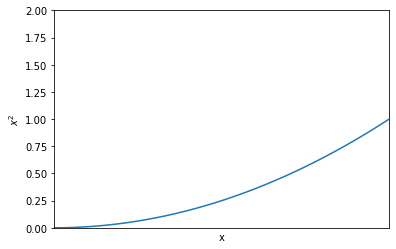

In [32]:
xp = np.linspace(0, 10, 1000)

plt.xlim(0, 1)
plt.ylim(0, 2)

plt.xlabel('x')
plt.ylabel('$x^2$')

# Disable ticks
plt.xticks([])

plt.plot(xp, xp**2)

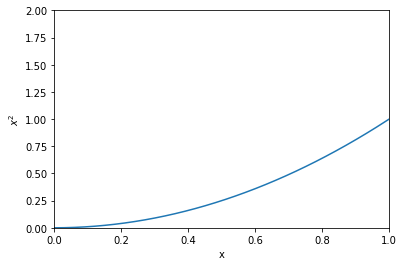

In [33]:
xp = np.linspace(0, 10, 1000)

plt.xlim(0, 1)
plt.ylim(0, 2)

plt.xlabel('x')
plt.ylabel('$x^2$')

# Disable ticks
plt.xticks()

plt.plot(xp, xp**2)

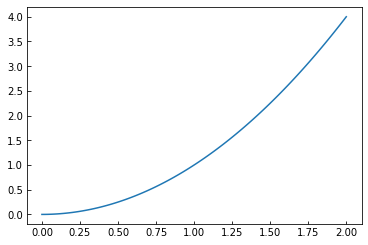

In [48]:
plt.rcParams['xtick.direction'] = 'in'
plt.rcParams['ytick.direction'] = 'in'
plt.plot(x, x**2)

In [49]:
plt.rcParams['xtick.direction'] = 'out'
plt.rcParams['ytick.direction'] = 'out'

([<matplotlib.axis.XTick at 0x1d884e9dcf8>,
 <a list of 5 Text xticklabel objects>)

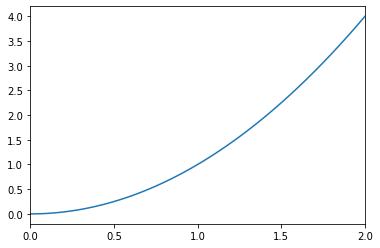

In [57]:
plt.plot(x, x**2)
plt.xlim(0, 2)
plt.xticks(np.arange(0, 2.1, 0.5))

## Details of plots

### Color and alpha

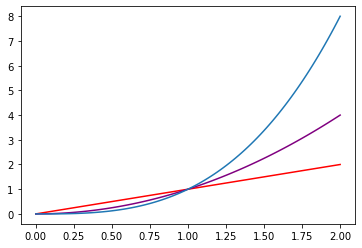

In [20]:
plt.plot(x, x, color='red')
plt.plot(x, x**2, color='purple')
plt.plot(x, x**3)

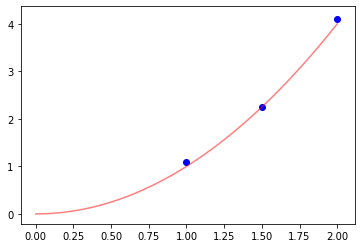

In [34]:
plt.plot(x, x**2, color='red', alpha=0.5)
plt.scatter([1, 1.5, 2], [1.1, 2.24, 4.1], color='blue')

### z-order

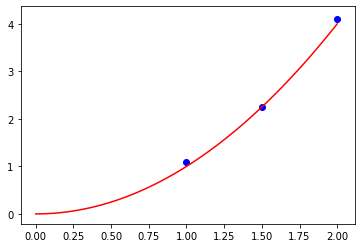

In [37]:
plt.plot(x, x**2, color='red')
plt.scatter([1, 1.5, 2], [1.1, 2.24, 4.1], color='blue')

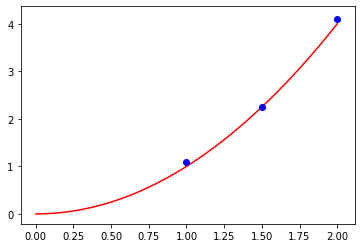

In [38]:
plt.plot(x, x**2, color='red', zorder=10)
plt.scatter([1, 1.5, 2], [1.1, 2.24, 4.1], color='blue', zorder=20)

### Size

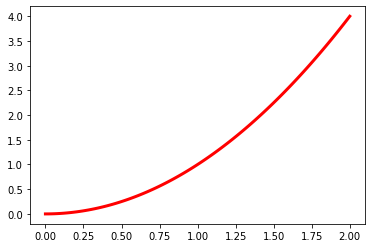

In [39]:
plt.plot(x, x**2, color='red', linewidth=3)

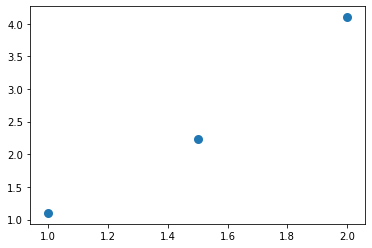

In [41]:
plt.scatter([1, 1.5, 2], [1.1, 2.24, 4.1], linewidth=3)

### Line style

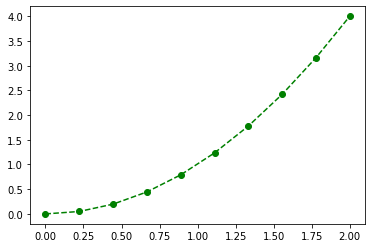

In [43]:
xp = np.linspace(0, 2, 10)
plt.plot(xp, xp**2, 'o--g')

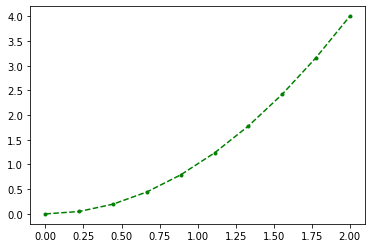

In [44]:
xp = np.linspace(0, 2, 10)
plt.plot(xp, xp**2, '.--g')

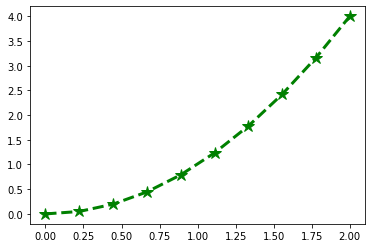

In [47]:
plt.plot(xp, xp**2, '*--g', linewidth=3, markersize=12)

## Labeling plots and configuration of legends

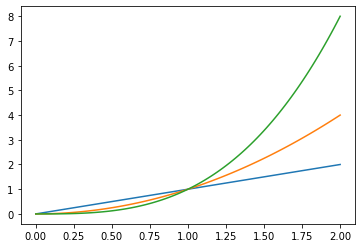

In [11]:
plt.plot(x, x, label='linear')
plt.plot(x, x**2, label='quadratic')
plt.plot(x, x**3, label='cubic')

Seems like nothing happened. But if we add a legend:

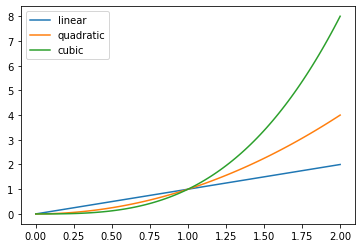

In [13]:
plt.plot(x, x, label='linear')
plt.plot(x, x**2, label='quadratic')
plt.plot(x, x**3, label='cubic')
plt.legend()

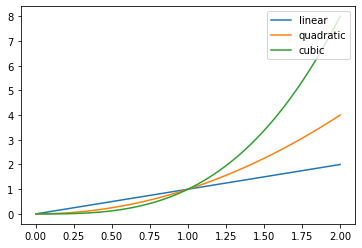

In [51]:
plt.plot(x, x, label='linear')
plt.plot(x, x**2, label='quadratic')
plt.plot(x, x**3, label='cubic')
plt.legend(loc='upper right')

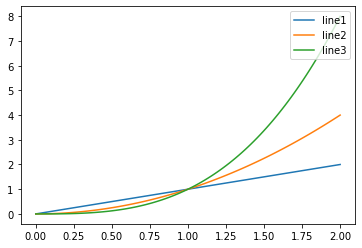

In [53]:
line1, = plt.plot(x, x, label='linear')
line2, = plt.plot(x, x**2, label='quadratic')
line3, = plt.plot(x, x**3, label='cubic')
plt.legend((line1, line2, line3), ('line1', 'line2', 'line3'), loc='upper right')

# Peusodo color

## Spectrogram

To plot the spectrogram of a discrete signal means to equally divided the signal into periods (called *frames*) and perform FFT to each frame, and then place the spectrum of each frame as columes from left to right in time order.

If there is a component in the signal whose period is much more smaller then the length of a frame, then it leaves a line with its frequency on the spectrogram. If, on the other hand, there is a component whose period is much more longer, then it will not be recognized and may be intepreted as "amplitude change".
That is why the length of each frame needs fine tuning: if it is very large, then we can capture phenomenon with large period, but there will be too few frames and the spectrogram is not smooth enough in the horizental axis, and if it is very small, the spectrogram looks smooth but low-frequency signals will be missed.
In other words, lifting the frame length increases frequency resolution ratio but decreases time resolution ratio, and lowering the frame length has reversed effects.
It should be noted, however, that both time resolution and frequency resolution cannot be improved unrestrictedly. For a $N$-point signal with time span of $T$, the uncertainty of frequency is $\Delta f \sim \frac{2\pi}{T}$, and the uncertainty of time if $\Delta t \sim \frac{T}{N}$.

An $N$-point signal with an $n$ point per second sampling rate results in an $N/2$-point FFT spectrum, and the unit of its scale is $n/N \; \mathrm{Hz}$. Therefore the maximal frequency is $n/2 \; \mathrm{Hz}$.

There is also one way to increase time resolution ratio - we may allow overlap between adjecent frames.

Below is an example. We created a signal with a total length of 100 seconds, and in each second there are $1 / 0.001 = 1000$ samples.

In [101]:
t = np.arange(0, 100, 0.001)
x = t**2 + np.sin(10*t) + np.cos(30*t)

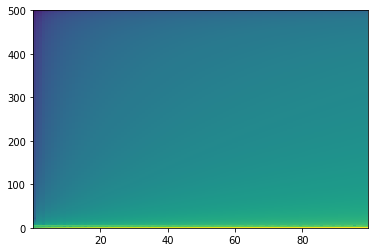

In [102]:
spec, freq, time, _ = plt.specgram(
    x,
    # The size of each frame, which is N.
    NFFT=1024, 
    # Samping rate. Note that it is only used for calculating the frequency and the time scale.
    Fs=1000
)

The result has a maximal frequency of 500 Hz, just as expected because $1000/2=500$.
The time scale is also correct.

Here comes the frequency. Each unit in the frequency scale means 0.9765625 Hz. Recall that $N=1024$ and $n=1000$, and $n/N=0.9765625$.

In [103]:
freq

array([  0.       ,   0.9765625,   1.953125 ,   2.9296875,   3.90625  ,
         4.8828125,   5.859375 ,   6.8359375,   7.8125   ,   8.7890625,
         9.765625 ,  10.7421875,  11.71875  ,  12.6953125,  13.671875 ,
        14.6484375,  15.625    ,  16.6015625,  17.578125 ,  18.5546875,
        19.53125  ,  20.5078125,  21.484375 ,  22.4609375,  23.4375   ,
        24.4140625,  25.390625 ,  26.3671875,  27.34375  ,  28.3203125,
        29.296875 ,  30.2734375,  31.25     ,  32.2265625,  33.203125 ,
        34.1796875,  35.15625  ,  36.1328125,  37.109375 ,  38.0859375,
        39.0625   ,  40.0390625,  41.015625 ,  41.9921875,  42.96875  ,
        43.9453125,  44.921875 ,  45.8984375,  46.875    ,  47.8515625,
        48.828125 ,  49.8046875,  50.78125  ,  51.7578125,  52.734375 ,
        53.7109375,  54.6875   ,  55.6640625,  56.640625 ,  57.6171875,
        58.59375  ,  59.5703125,  60.546875 ,  61.5234375,  62.5      ,
        63.4765625,  64.453125 ,  65.4296875,  66.40625  ,  67.3

Sometimes we just want a few frames rather then the whole spectrum.
Frames are stored in the first returned value, but keep in mind that they are organized exactly in the way displayed in the spectrogram - that is, frames are stored in *columns* instead of rows.

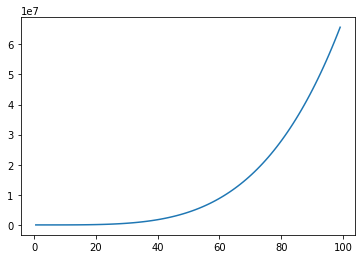

In [104]:
plt.plot(time, spec[0])

Here are two graphs illustrating the 10th column on the spectrogram.

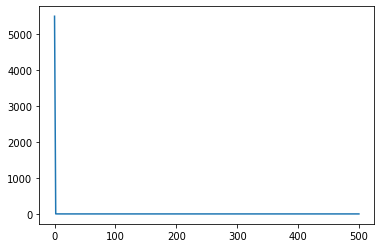

In [105]:
plt.plot(freq, spec[:, 10])

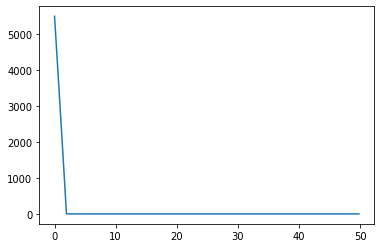

In [106]:
plt.plot(freq[freq<50], spec[:,10][freq<50])

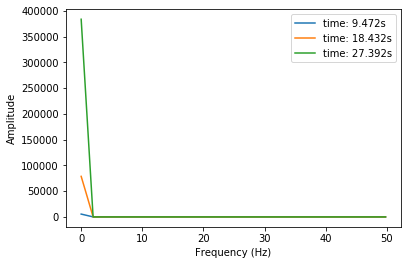

In [107]:
for t_index in (10, 20, 30):
    plt.plot(freq[freq<50], spec[:,t_index][freq<50], label=f'time: {time[t_index]}s')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.legend()

Now it's time to fine tuning the spectrogram.

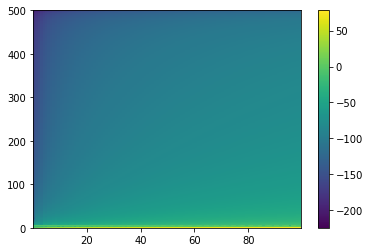

In [108]:
spec, freq, time, _ = plt.specgram(x, NFFT=1024, Fs=1000)
plt.colorbar()

## Colormesh

In [9]:
dx, dy = 0.01, 0.01
x, y = np.mgrid[0:5+dx:dx, 0:4+dy:dy]
z = np.sin(x*y)

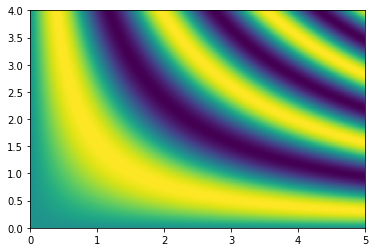

In [10]:
plt.pcolormesh(x, y, z)

## Colorbar

In [109]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

# Components of Matploblib graphs

In [6]:
fig1 = plt.figure()
fig1.suptitle('No axes on this figure')

Text(0.5, 0.98, 'No axes on this figure')

<Figure size 432x288 with 0 Axes>

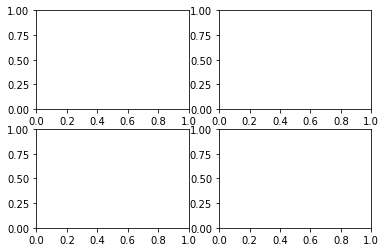

In [8]:
fig2, ax_list = plt.subplots(2, 2)

# The structure of each figure

In [2]:
a = np.arange(1, 5)
b = a**2
c = a**3

In [7]:
ax

array([<matplotlib.axes._subplots.AxesSubplot object at 0x000002689E0D80B8>,
      dtype=object)

In [11]:
ax[0].plot(a, b)
ax[1].plot(b, a)